## 2D Diffusion

Two dimensional diffusion is governed by the partial differential equation:

$$\frac{\partial u}{\partial t} = \nu \frac{\partial ^2 u}{\partial x^2} + \nu \frac{\partial ^2 u}{\partial y^2}$$

Using a similar process to what we did for 1D diffusion, we can produce the following discretisation:

$$ u_{i,j}^{n+1} = u_{i,j}^n + \frac{\nu \Delta t}{\Delta x^2}(u_{i+1,j}^n - 2 u_{i,j}^n + u_{i-1,j}^n) + \frac{\nu \Delta t}{\Delta y^2}(u_{i,j+1}^n-2 u_{i,j}^n + u_{i,j-1}^n) $$

### Grid and Initial Condition

Text(0.5, 0.92, 'Initial Condition for 2D Diffusion')

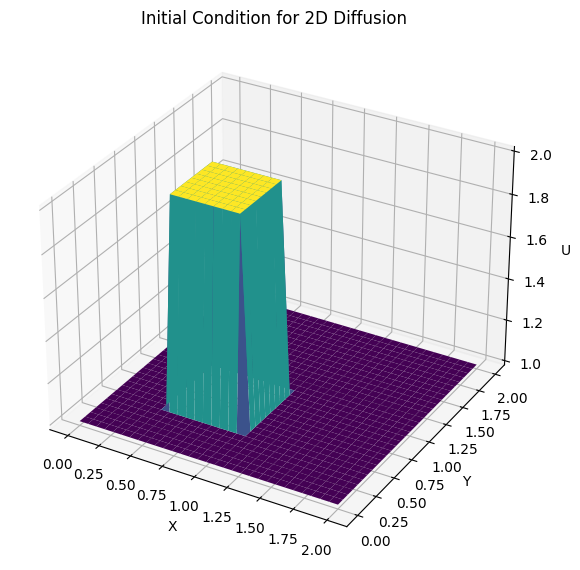

In [1]:
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from matplotlib import pyplot, cm
%matplotlib inline

#define our 2D grid, and get the time step using CFL condition to ensure convergence
x_len = 2
y_len = 2
num_x = 31
num_y = 31
num_t = 17

sigma = 0.25
nu = 0.05

del_x = x_len / (num_x - 1)
del_y = y_len / (num_y - 1)
del_t = sigma * del_x * del_y / nu

#set x, y, and assign initial conditions for u
x = np.linspace(0, x_len, num_x)
y = np.linspace(0, y_len, num_x)

u = np.ones((num_y, num_x))
u[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

#plot the initial conditions
figure = pyplot.figure(figsize=(11, 7), dpi=100)
axes = figure.gca(projection='3d')
X, Y = np.meshgrid(x, y)
surface = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y')
axes.set_zlabel('U')
axes.set_title('Initial Condition for 2D Diffusion')

### Solve

$$ u_{i,j}^{n+1} = u_{i,j}^n + \frac{\nu \Delta t}{\Delta x^2}(u_{i+1,j}^n - 2 u_{i,j}^n + u_{i-1,j}^n) + \frac{\nu \Delta t}{\Delta y^2}(u_{i,j+1}^n-2 u_{i,j}^n + u_{i,j-1}^n) $$

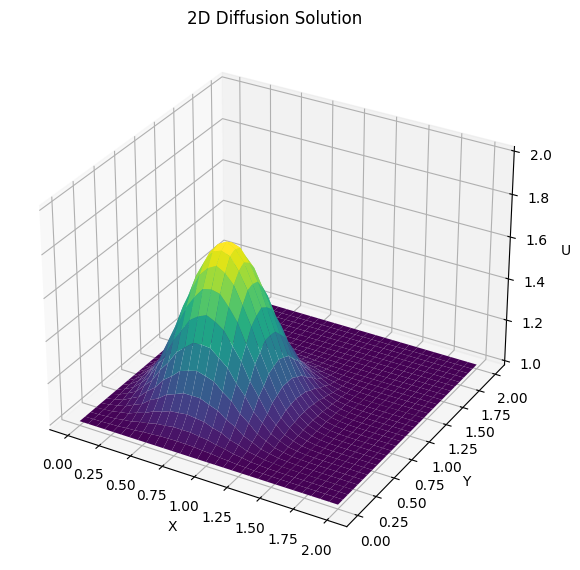

In [2]:
def diffuse(num_t):
    for n in range(num_t + 1):
        u_n = u.copy()
        
        #main computation
        u[1:-1 , 1:-1] = u_n[1:-1 , 1:-1] + \
                         nu * del_t/del_x**2 * (u_n[1:-1 , 2:] - 2*u_n[1:-1 , 1:-1] + u_n[1:-1, :-2]) +\
                         nu * del_t/del_x**2 * (u_n[2: , 1:-1] - 2*u_n[1:-1 , 1:-1] + u_n[:-2 , 1:-1])
        
        #boundary conditions
        u[0, :] = 1
        u[-1, :] = 1
        u[: , 0] = 1
        u[: , -1] = 1
        
    #plot in 3d
    figure = pyplot.figure(figsize=(11, 7), dpi=100)
    axes = figure.gca(projection='3d')
    surface2 = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
    axes.set_xlabel('X')
    axes.set_ylabel('Y')
    axes.set_zlabel('U')
    axes.set_zlim(1, 2)
    axes.set_title('2D Diffusion Solution')
    
diffuse(num_t)
    

### Animate

Animation may not display correctly if viewed on Github.

First, generate the figure to display our animation on:

Text(0.5, 0.92, '2D Diffusion Time Evolution')

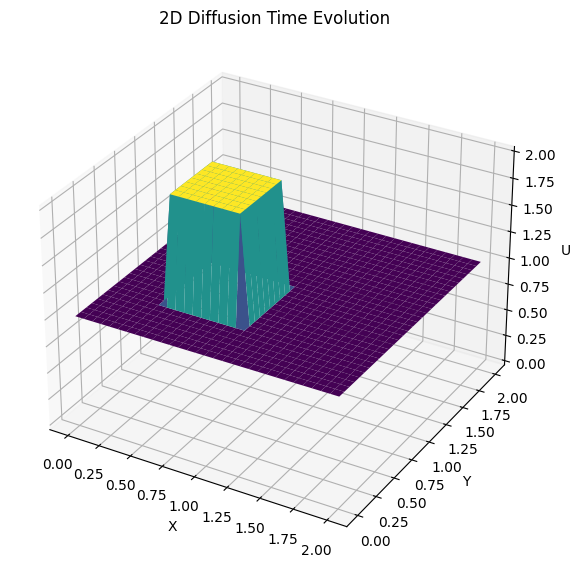

In [3]:
from matplotlib import animation, rc 
from IPython.display import HTML

#reset the initial conditions
u = np.ones((num_y, num_x))
u[ int(0.5 / del_y) : int(1 / del_y + 1) , int(0.5 / del_x) : int(1 / del_x +1) ] = 2

#generate the figure
figure = pyplot.figure(figsize=(11,7), dpi=100)
axes = figure.gca(projection='3d')

surface = axes.plot_surface(X, Y, u[:] , cmap=cm.viridis)
axes.set_xlabel('X')
axes.set_ylabel('Y');
axes.set_zlabel('U')
axes.set_zlim(0, 2)
axes.set_title('2D Diffusion Time Evolution')

Initialise and re-solve. Each frame of the animation is a time step

In [4]:
def init_anim():
    axes.clear()
    surface = axes.plot_surface(X, Y, u[:], cmap=cm.viridis)
    return surface

def animate(j):
    u_n = u.copy()
    
    #main computation
    u[1:-1 , 1:-1] = u_n[1:-1 , 1:-1] + \
                    nu * del_t/del_x**2 * (u_n[1:-1 , 2:] - 2*u_n[1:-1 , 1:-1] + u_n[1:-1, :-2]) +\
                    nu * del_t/del_x**2 * (u_n[2: , 1:-1] - 2*u_n[1:-1 , 1:-1] + u_n[:-2 , 1:-1])
        
    #boundary conditions
    u[0, :] = 1
    u[-1, :] = 1
    u[: , 0] = 1
    u[: , -1] = 1
    
    #add frame
    axes.clear()
    surface = axes.plot_surface(X, Y, u[:] , cmap=cm.viridis)
    axes.set_xlabel('X')
    axes.set_ylabel('Y');
    axes.set_zlabel('U')
    axes.set_zlim(0, 2)
    axes.set_title('2D Diffusion Time Evolution')
    return surface

#so that we don't hit the animation embed limit
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

anim = animation.FuncAnimation(figure, animate, init_func=init_anim, frames=5*num_t, interval=20)
HTML(anim.to_jshtml())